<a href="https://colab.research.google.com/github/LavaLionRider/Multi_Useful_Python3_Programmes/blob/main/YOLOV5_training_custom_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Install Dependencies

_(Remember to choose GPU in Runtime if not already selected. Runtime --> Change Runtime Type --> Hardware accelerator --> GPU)_

In [1]:
!nvidia-smi

Thu May  6 11:01:05 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   62C    P8    11W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
!touch requirement.txt
!echo "" > requirement.txt
!echo "# base ----------------------------------------" >> requirement.txt
!echo "Cython" >> requirement.txt
!echo "matplotlib" >> requirement.txt
!echo "numpy" >> requirement.txt
!echo "opencv-python" >> requirement.txt
!echo "Pillow" >> requirement.txt
!echo "PyYAML>=5.4" >> requirement.txt
!echo "scipy" >> requirement.txt
!echo "tensorboard" >> requirement.txt
!echo "torch" >> requirement.txt
!echo "torchvision" >> requirement.txt
!echo "tqdm" >> requirement.txt
!echo "wandb" >> requirement.txt
!echo "utils" >> requirement.txt
!echo "google-utils" >> requirement.txt
!echo "# plotting ------------------------------------" >> requirement.txt
!echo "seaborn" >> requirement.txt
!echo "pandas" >> requirement.txt

!echo "# export --------------------------------------" >> requirement.txt
!echo "coremltools" >> requirement.txt
!echo "onnx" >> requirement.txt
!echo "scikit-learn  # for coreml quantization" >> requirement.txt

!echo "# extras --------------------------------------" >> requirement.txt
!echo "thop  # FLOPS computation" >> requirement.txt
!echo "pycocotools  # COCO mAP" >> requirement.txt

!pip install -r requirement.txt


     |████████████████████████████████| 645kB 19.5MB/s 
     |████████████████████████████████| 2.1MB 41.7MB/s 
     |████████████████████████████████| 3.4MB 50.3MB/s 
     |████████████████████████████████| 12.2MB 41.7MB/s 
     |████████████████████████████████| 133kB 55.6MB/s 
     |████████████████████████████████| 102kB 13.8MB/s 
     |████████████████████████████████| 163kB 56.5MB/s 
     |████████████████████████████████| 71kB 10.8MB/s 
  Created wheel for pathtools: filename=pathtools-0.1.2-cp37-none-any.whl size=8786 sha256=a4a5c66dd26507458e05d1044c793b7bbb40c50f8e6ff866ab7856bf031e5035
  Stored in directory: /root/.cache/pip/wheels/0b/04/79/c3b0c3a0266a3cb4376da31e5bfe8bba0c489246968a68e843
  Created wheel for subprocess32: filename=subprocess32-3.5.4-cp37-none-any.whl size=6489 sha256=2158519dcba70341939de00d463c218c61e4dc8a4cb87fc91043187bbe4eb789
  Stored in directory: /root/.cache/pip/wheels/68/39/1a/5e402bdfdf004af1786c8b853fd92f8c4a04f22aad179654d1
  Created wheel for 

# Clone and Upload
## you can replace the default link with your datasets' link.

In [4]:
# Export code snippet and paste here
!git clone https://github.com/ultralytics/yolov5.git
!curl -L "https://www.dropbox.com/s/du0fy3fcp8dqv2f/dataset3000yolo360pxl.zip?dl=0" > dataset3000yolo360pxl.zip; unzip dataset3000yolo360pxl.zip; rm dataset3000yolo360pxl.zip
#!curl -L "https://www.dropbox.com/s/oo2y7beciqrd64k/dataset3000yolo.zip?dl=0" > dataset3000yolo.zip; unzip dataset3000yolo.zip; rm dataset3000yolo.zip

%cd yolov5

import torch

from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Streaming output truncated to the last 5000 lines.
  inflating: train/labels/armas_1602.txt  
  inflating: train/labels/armas_333.txt  
  inflating: train/labels/armas_2100.txt  
  inflating: train/labels/armas_1648.txt  
  inflating: train/labels/armas_1830.txt  
  inflating: train/labels/armas_1218.txt  
  inflating: train/labels/armas_1629.txt  
  inflating: train/labels/armas_1592.txt  
  inflating: train/labels/armas_453.txt  
  inflating: train/labels/armas_640.txt  
  inflating: train/labels/armas_1872.txt  
  inflating: train/labels/armas_629.txt  
  inflating: train/labels/armas_658.txt  
  inflating: train/labels/armas_563.txt  
  inflating: train/labels/armas_620.txt  
  inflating: train/labels/armas_2106.txt  
  inflating: train/labels/armas_1969.txt  
  inflating: train/labels/armas_1372.txt  
  inflating: train/labels/armas_460.txt  
  inflating: train/labels/armas_2101.txt  
  inflating: train/labels/armas_262.txt  
  inflating: train/labels/armas_448.txt  
  inflating: 

In [ ]:
# this the data.yamal information is going to be used
#nc = number of classes
%cd /content
%cat data.yaml

/content
cat: data.yaml: No such file or directory


# Define Model Configuration and Architecture

We will write a yaml script that defines the parameters for our model like the number of classes, anchors, and each layer.

You do not need to edit these cells, but you may.

In [ ]:
# define number of classes based on YAML
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [ ]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [ ]:
%%writetemplate /content/yolov5/models/custom1_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [ ]:
#this is the model configuration we will use for our tutorial 
%cat /content/yolov5/models/yolov5s.yaml


# parameters
nc: 1  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-

In [ ]:
!ls

data.yaml  requirement.txt  sample_data  test  train  valid  yolov5


# Train Custom YOLOv5 Detector

### Next, we'll fire off training!


Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** set the path to our yaml file
- **cfg:** specify our model configuration
- **weights:** specify a custom path to weights. (Note: you can download weights from the Ultralytics Google Drive [folder](https://drive.google.com/open?id=1Drs_Aiu7xx6S-ix95f9kNsA6ueKRpN2J))
- **name:** result names
- **nosave:** only save the final checkpoint
- **cache:** cache images for faster training

In [ ]:
# train yolov5s on custom data for 100 epochs
# time its performance
%%time
%cd /content/yolov5/
!python train.py --img 480 --batch 16 --epochs 100 --data '../data.yaml' --cfg ./models/yolov5s.yaml --weights yolov5s.pt --name yolov5s-3000img-100epch_480pixl --nosave --cache

/content/yolov5
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v5.0-26-g14d2d2d torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Namespace(adam=False, artifact_alias='latest', batch_size=16, bbox_interval=-1, bucket='', cache_images=True, cfg='./models/custom1_yolov5s.yaml', data='../data.yaml', device='', entity=None, epochs=100, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[360, 360], label_smoothing=0.0, linear_lr=False, local_rank=-1, multi_scale=False, name='yolov5s-3000img-100epch_360pixel', noautoanchor=False, nosave=True, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/yolov5s-3000img-100epch_360pixel', save_period=-1, single_cls=False, sync_bn=False, total_batch_size=16, upload_dataset=False, weights='yolov5s.pt', workers=8, world_size=1)
tensorboard: Start with 'tensorboard --logdir runs/train', view at http://localhost:6006/
2021-04-23 12:10:30

# Evaluate Custom YOLOv5 Detector Performance

Training losses and performance metrics are saved to Tensorboard and also to a logfile defined above with the **--name** flag when we train. In our case, we named this `yolov5s_results`. (If given no name, it defaults to `results.txt`.) The results file is plotted as a png after training completes.

Note from Glenn: Partially completed `results.txt` files can be plotted with `from utils.utils import plot_results; plot_results()`.

In [ ]:
!python --version

Python 3.7.10


In [ ]:
%reload_ext tensorboard

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='/content/yolov5/runs/train/yolov5s-3000img-100epch_240pixel/results.png', width=1000)  # view results.png

FileNotFoundError: ignored

### Curious? Visualize Our Training Data with Labels

After training starts, view `train*.jpg` images to see training images, labels and augmentation effects.

Note a mosaic dataloader is used for training (shown below), a new dataloading concept developed by Glenn Jocher and first featured in [YOLOv4](https://arxiv.org/abs/2004.10934).

GROUND TRUTH TRAINING DATA:


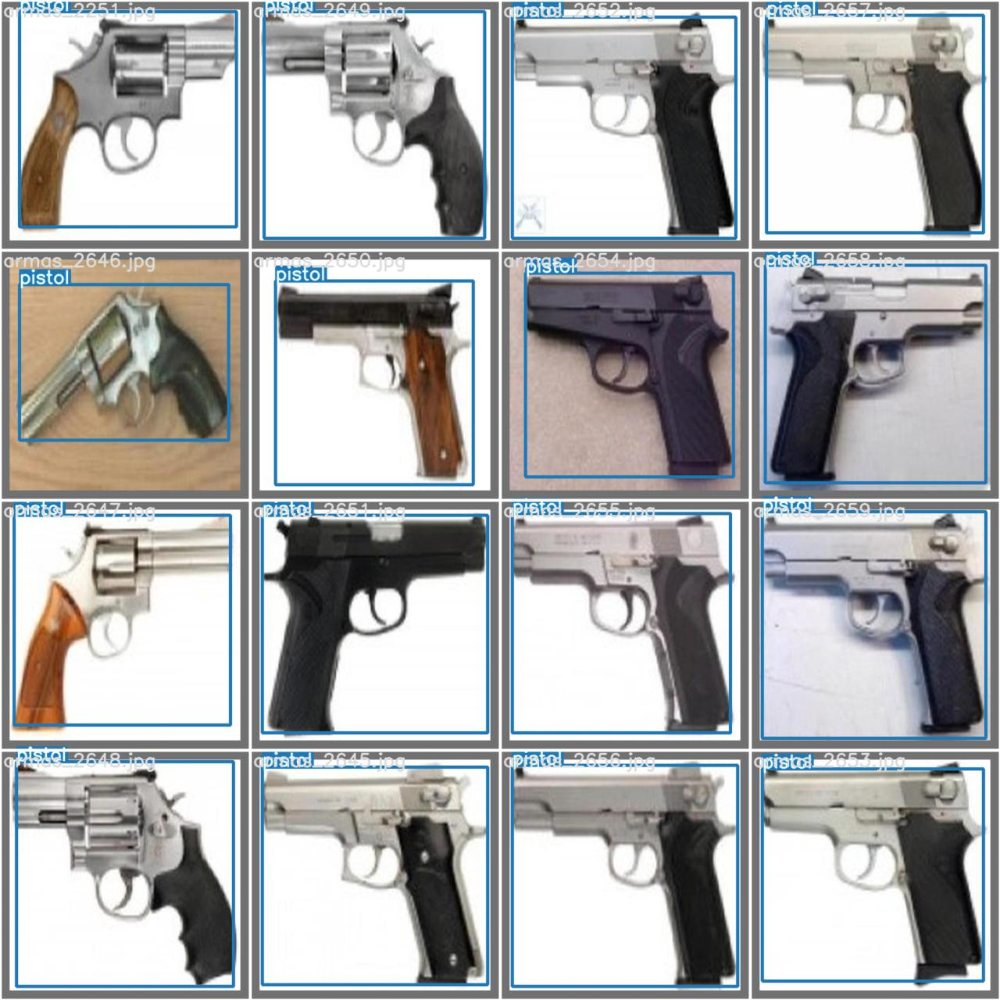

In [ ]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s-3000img-100epch_360pixel/test_batch0_labels.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


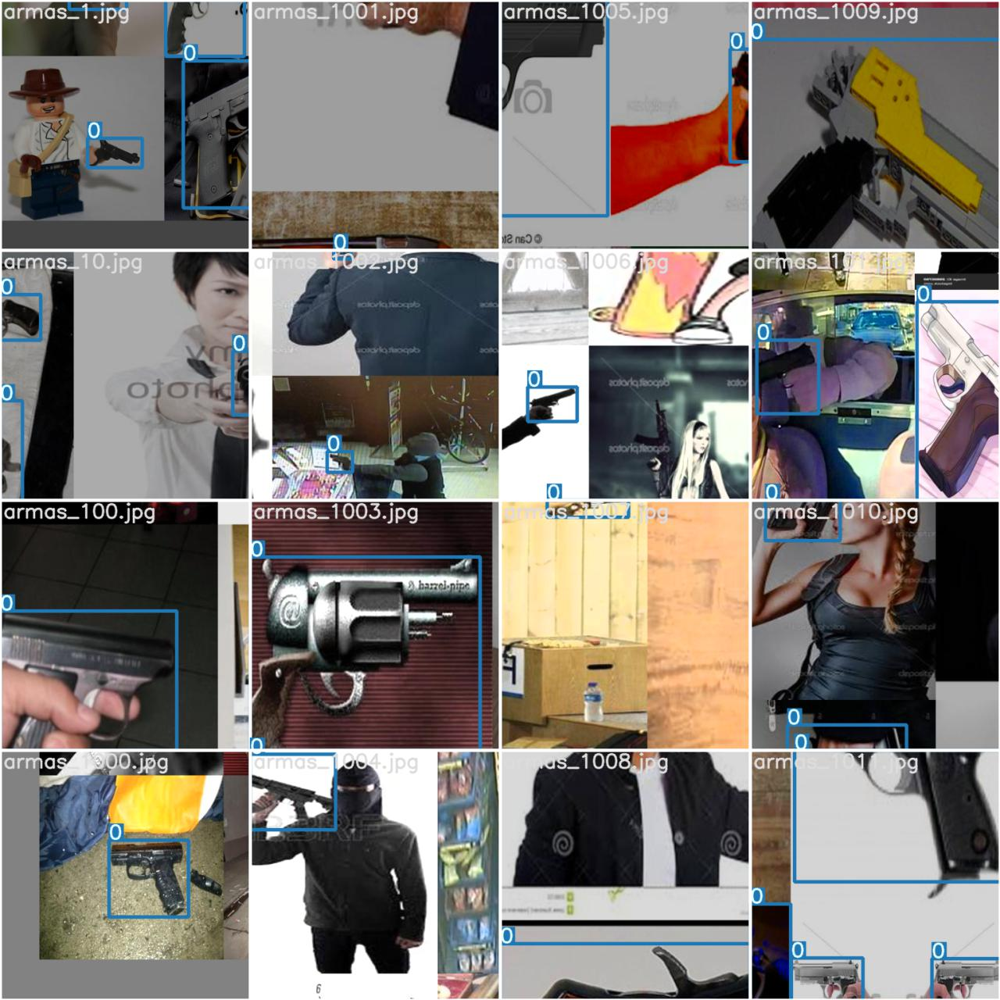

In [ ]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s-3000img-100epch_360pixel/train_batch0.jpg', width=900)

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [ ]:

%cd yolov5/
%ls

[Errno 2] No such file or directory: 'yolov5/'
/content/yolov5
data/       hubconf.py  __pycache__/       runs/     tutorial.ipynb  weights/
detect.py   LICENSE     README.md*         test.py   utils/          yolov5s.pt
Dockerfile  models/     requirements.txt*  train.py  wandb/


In [ ]:
# trained weights are saved by default in our weights folder
%ls runs/

train/


In [ ]:
%ls runs/train/yolov5s_results/weights

ls: cannot access 'runs/train/yolov5s_results/weights': No such file or directory


In [ ]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s-3000img-100epch_360pixel/weights/last.pt --img 120 --conf 0.4 --source ../test/images

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', exist_ok=False, img_size=120, iou_thres=0.45, name='exp', nosave=False, project='runs/detect', save_conf=False, save_crop=False, save_txt=False, source='../test/images', update=False, view_img=False, weights=['runs/train/yolov5s-3000img-100epch_360pixel/weights/last.pt'])
YOLOv5 🚀 v5.0-26-g14d2d2d torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 232 layers, 7246518 parameters, 0 gradients, 16.8 GFLOPS
image 1/150 /content/yolov5/../test/images/test1.jpg: 128x128 Done. (0.007s)
image 2/150 /content/yolov5/../test/images/test10.jpg: 128x128 Done. (0.009s)
image 3/150 /content/yolov5/../test/images/test100.jpg: 128x128 1 pistol, Done. (0.012s)
image 4/150 /content/yolov5/../test/images/test101.jpg: 128x128 1 pistol, Done. (0.008s)
image 5/150 /content/yolov5/../test/images/test102.jpg: 128x128 1 pistol, Done. (0.008s)
image 6/150 /content/yolov5/../test/im

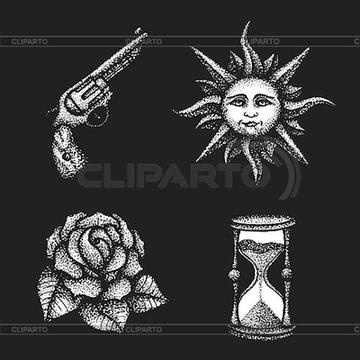

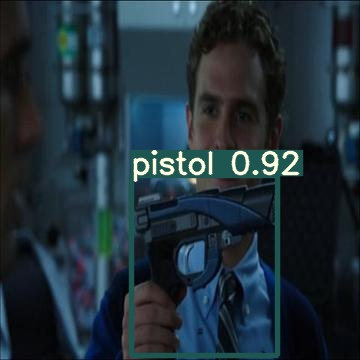

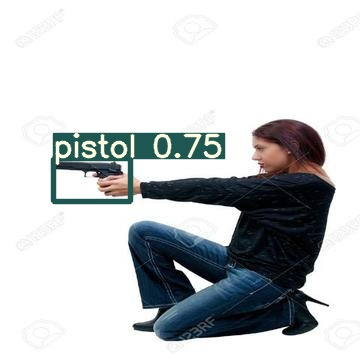

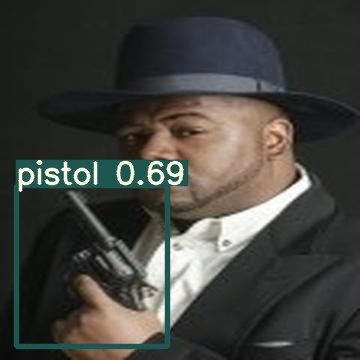

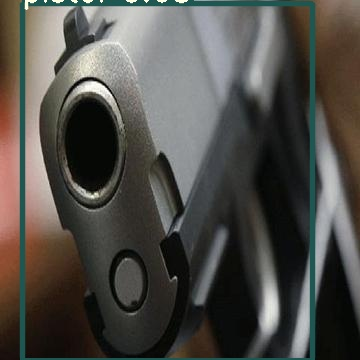

...

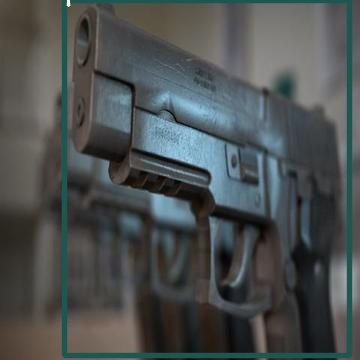

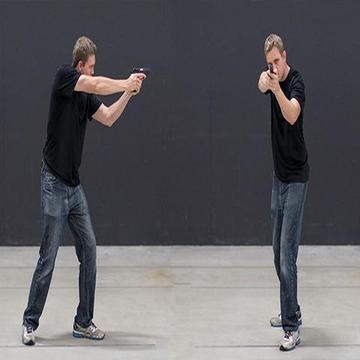

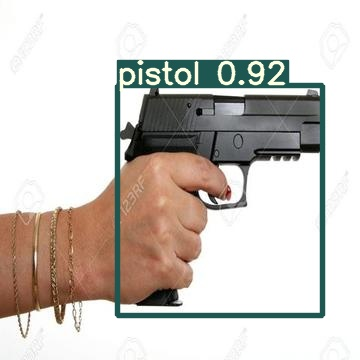

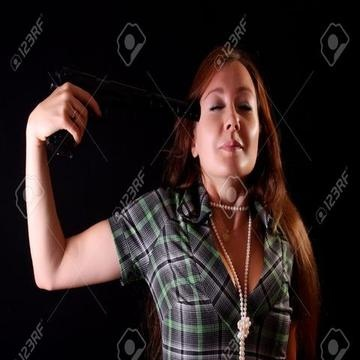

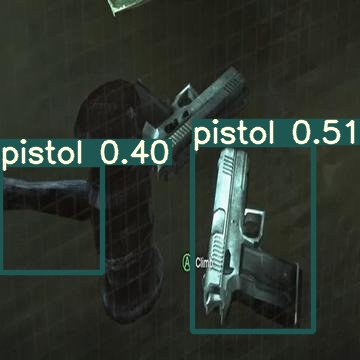

In [ ]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Export Trained Weights for Future Inference

Now that you have trained your custom detector, you can export the trained weights you have made here for inference on your device elsewhere

In [ ]:
!ls

data	    hubconf.py	__pycache__	  runs	    tutorial.ipynb  weights
detect.py   LICENSE	README.md	  test.py   utils	    yolov5s.pt
Dockerfile  models	requirements.txt  train.py  wandb


#Compress the model!
## The following node compress the yolov5 folder to a zip file wich can be downloaded from colab 

In [ ]:
%cd /content
!zip -r yolov5s-3000img-100epch_360pixel.zip yolov5/

/content
  adding: yolov5/ (stored 0%)
  adding: yolov5/train.py (deflated 70%)
  adding: yolov5/.dockerignore (deflated 56%)
  adding: yolov5/detect.py (deflated 65%)
  adding: yolov5/LICENSE (deflated 66%)
  adding: yolov5/requirements.txt (deflated 51%)
  adding: yolov5/.gitignore (deflated 56%)
  adding: yolov5/test.py (deflated 66%)
  adding: yolov5/__pycache__/ (stored 0%)
  adding: yolov5/__pycache__/test.cpython-37.pyc (deflated 41%)
  adding: yolov5/README.md (deflated 62%)
  adding: yolov5/data/ (stored 0%)
  adding: yolov5/data/scripts/ (stored 0%)
  adding: yolov5/data/scripts/get_coco.sh (deflated 51%)
  adding: yolov5/data/scripts/get_voc.sh (deflated 62%)
  adding: yolov5/data/scripts/get_argoverse_hd.sh (deflated 55%)
  adding: yolov5/data/coco128.yaml (deflated 51%)
  adding: yolov5/data/images/ (stored 0%)
  adding: yolov5/data/images/bus.jpg (deflated 1%)
  adding: yolov5/data/images/zidane.jpg (deflated 0%)
  adding: yolov5/data/voc.yaml (deflated 42%)
  adding: yol